In [1]:
from google.colab import drive
drive.mount('/content/drive')
!pip install torchinfo

Mounted at /content/drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd /content/drive/MyDrive/Artificial Intelligence/Covid19CT_Experiment

[Errno 2] No such file or directory: '/content/drive/MyDrive/Artificial Intelligence/Covid19CT_Experiment'
/content


In [2]:
import os

print(os.getcwd())
path = "/content/drive/MyDrive/covid19/Covid19CT_Experiment"
os.chdir(path)
print(os.getcwd())

/content
/content/drive/MyDrive/covid19/Covid19CT_Experiment


In [3]:
import os
from pathlib import Path
import sys

# For Google Colab and Project/test.ipynb
project_path = str(Path().absolute())

if project_path not in sys.path:
    sys.path.append(project_path)

os.listdir(project_path)

['Covid19CT_ResNet50_AdamW_1e-4.ipynb',
 'Covid19CT_ResNet50_Adam_5e-5.ipynb',
 'Results.xlsx',
 'DataSplit',
 'Database',
 'src',
 'Experimental Results',
 'Covid19CT_ResNet50_without_lr_scheduler.ipynb',
 'Covid19CT_SENet50_CosineAnnealingLR_Adam1e-4.ipynb',
 'Covid19CT_ResNet50_without_lr_scheduler&colorjitter.ipynb',
 'Covid19CT_ResNet50_CosineAnnealingLR_Adam1e-4.ipynb',
 'Covid19CT_ResNet50_without_lr_scheduler_lr=0.03.ipynb',
 'ResNet50_without_lr_scheduler_lr=0.0006.ipynb',
 'ResNet50_with_lr_scheduler_lr=0.0006.ipynb',
 'CBAMNet50_with_lr_scheduler_lr=0.0006.ipynb',
 'ECANet50_with_lr_scheduler_lr=0.0006.ipynb',
 'SEResNet50_with_lr_scheduler_lr=0.0006.ipynb',
 'DenseNet121_with_lr_scheduler_lr=0.0006.ipynb',
 'DenseNet169_with_lr_scheduler_lr=0.0006.ipynb',
 'CBAMResNet50_lr=0.0006_epoch 4.ipynb',
 'ECAResNet50_lr=0.0006_epoch 4.ipynb',
 'SEResNet50_lr=0.0006_epoch 4.ipynb',
 'DenseNet121_lr=0.0006_epoch 4.ipynb',
 'DenseNet169_lr=0.0006_epoch 4.ipynb',
 'DenseNet121_CBAM_lr=

In [4]:
pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 12.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.0-py3-none-any.whl size=38070 sha256=4ef34a6833ab37658cf2d2aab3e0a29f928bfe8e744321391ed617b15e1929f3
  Stored in directory: /root/.cache/pip/wheels/5b/e5/3d/8548241d5cffe53ad1476c566a61ad9bf09cc61a9430f09726
Successfully built grad-cam


In [5]:
import torch
import torch.nn as nn
from torch import optim
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

data_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize(224),
        transforms.CenterCrop(224),
    ])
data_normalize = transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])



/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


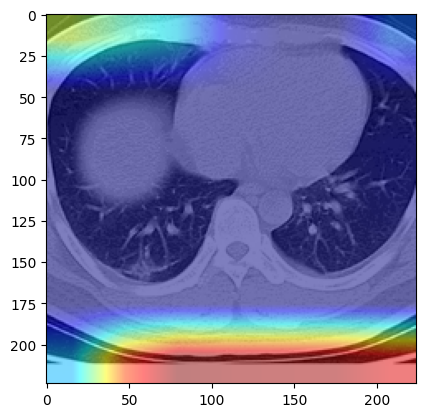

In [ ]:
# Example

img_path = "/content/drive/MyDrive/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/bmj.m606.full-p4-22%2.png"

assert os.path.exists(img_path), "file: '{}' dose not exist.".format(img_path)
img = Image.open(img_path).convert('RGB')
img = np.array(img, dtype=np.uint8)

model_1 = torch.load("/content/drive/MyDrive/Artificial Intelligence/Covid19CT_Experiment/Experimental Results/ResNet50_exp_setting/Best_RetNet-50.pkl")
target_layers_1 = [model_1.layer4[-1]]
model_1.layer4[-1]
cam_1 = GradCAM(model=model_1, target_layers=target_layers_1)

img_resize = data_transform(img)
img_normal = data_normalize(img_resize)
input_tensor = torch.unsqueeze(img_normal, dim=0)

grayscale_cam = cam_1(input_tensor=input_tensor)
grayscale_cam = grayscale_cam[0, :]

img_array = img_resize.numpy().astype(dtype=np.float32)
img_array = np.transpose(img_array, (1, 2, 0))

visualization = show_cam_on_image(img_array, grayscale_cam, use_rgb=True)

plt.imshow(visualization)
plt.show()

In [6]:
def gradcam_test(cam):
  positive_database_path = project_path + '/Database/CT_COVID'
  img_list = [
      "2020.02.26.20026989-p34-114_2%0.png",
      "2020.02.17.20024018-p17-61%3.png",
      "2020.02.24.20027052-p8-73%3.png",
      # "bmj.m606.full-p4-22%2.png",
      # "2020.03.25.20037721-p27-181.png",
      # "PIIS0140673620302117_1.png",
      ]

  for filename in img_list:
     if filename.endswith('.png'):
        file_path = os.path.join(positive_database_path, filename)
        print(file_path)
        assert os.path.exists(file_path), "file: '{}' dose not exist.".format(file_path)
        img = Image.open(file_path).convert('RGB')
        img = np.array(img, dtype=np.uint8)

        img_resize = data_transform(img)
        img_normal = data_normalize(img_resize)
        input_tensor = torch.unsqueeze(img_normal, dim=0)

        grayscale_cam = cam(input_tensor=input_tensor)
        grayscale_cam = grayscale_cam[0, :]

        img_array = img_resize.numpy().astype(dtype=np.float32)
        img_array = np.transpose(img_array, (1, 2, 0))

        visualization = show_cam_on_image(img_array, grayscale_cam, use_rgb=True)

        plt.imshow(visualization)
        plt.show()

# Find image

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.16.20035105-p6-64-2.png


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


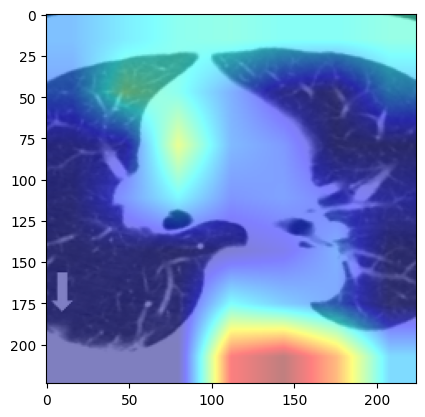

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.13.20035212-p23-160.png


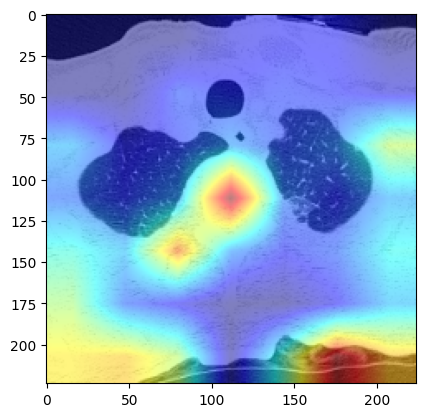

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.22.20040782-p25-1546.png


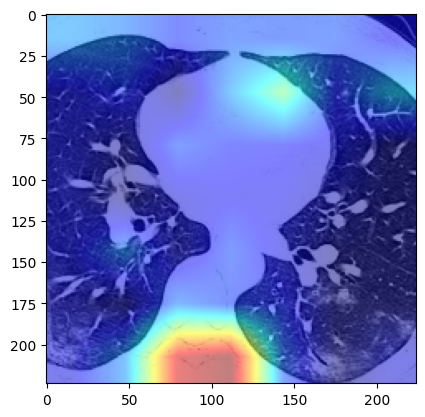

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.25.20021568-p24-111%5.png


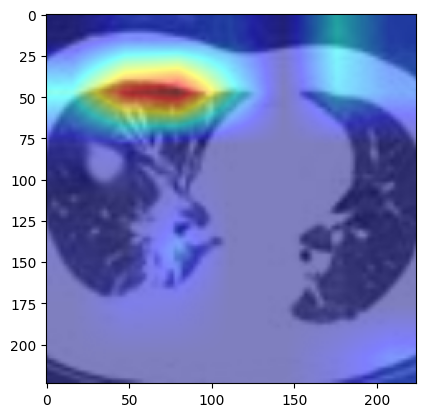

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.04.20026005-p12-1946%2.png


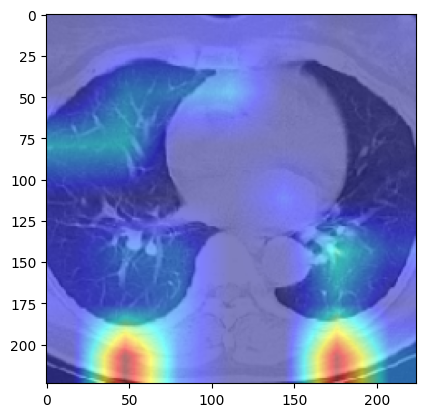

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.26.20041426-p11-123.png


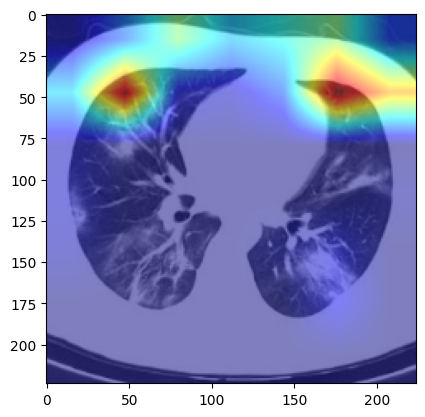

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.08.20031658-p15-105.png


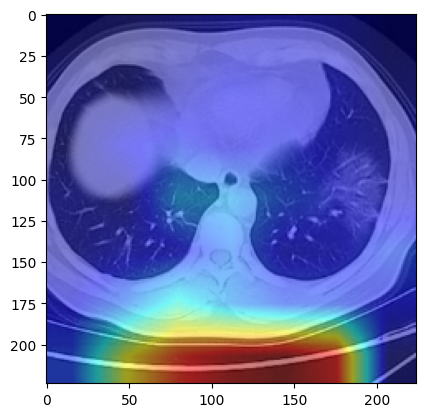

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.10.20021584-p6-52%5.png


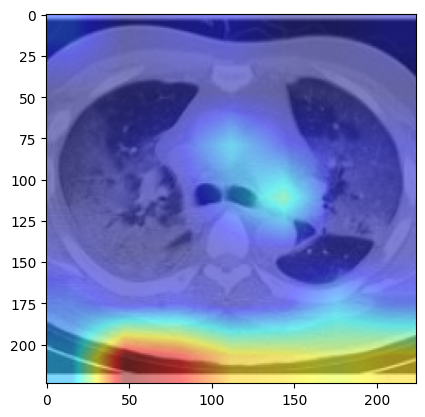

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.16.20036145-p19-128-3.png


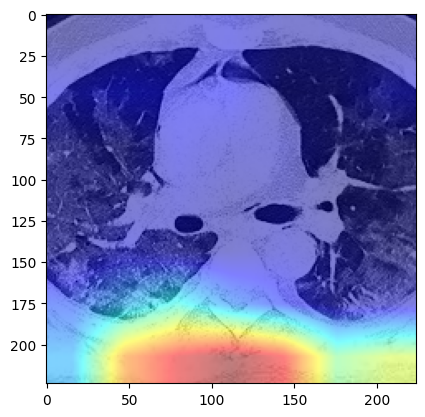

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/PIIS0140673620303603%2.png


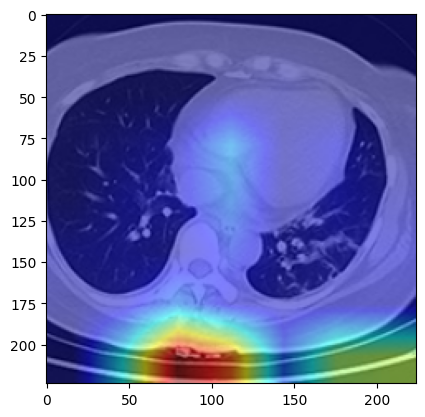

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.03.13.20035212-p23-162.png


Exception: ignored

In [ ]:
model_path = project_path + "/Experimental Results/CBAMResNet50_lr=0.0006_epoch-20240103T144528Z-001/CBAMResNet50_lr=0.0006_epoch/4/Best_CBAMRetNet-50.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
model.layer4[-1]
cam = GradCAM(model=model, target_layers=target_layers_1)

positive_database_path = project_path + '/Database/CT_COVID'
for filename in os.listdir(positive_database_path):
     if filename.endswith('.png'):  # 只处理以 .jpg 结尾的文件
        file_path = os.path.join(positive_database_path, filename)
        print(file_path)
        assert os.path.exists(file_path), "file: '{}' dose not exist.".format(file_path)
        img = Image.open(file_path).convert('RGB')
        img = np.array(img, dtype=np.uint8)

        img_resize = data_transform(img)
        img_normal = data_normalize(img_resize)
        input_tensor = torch.unsqueeze(img_normal, dim=0)

        grayscale_cam = cam(input_tensor=input_tensor)
        grayscale_cam = grayscale_cam[0, :]

        img_array = img_resize.numpy().astype(dtype=np.float32)
        img_array = np.transpose(img_array, (1, 2, 0))

        visualization = show_cam_on_image(img_array, grayscale_cam, use_rgb=True)

        plt.imshow(visualization)
        plt.show()

# ResNet50

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


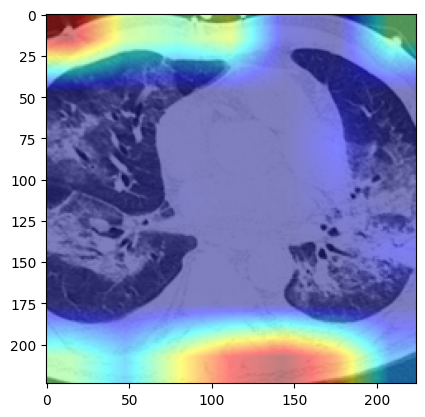

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


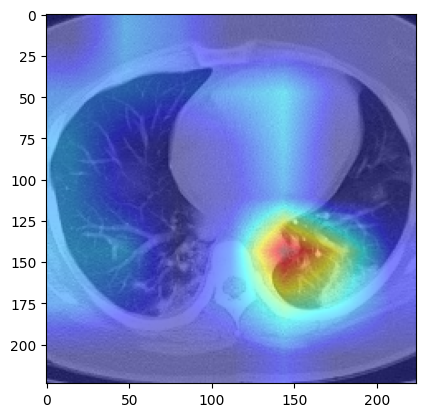

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


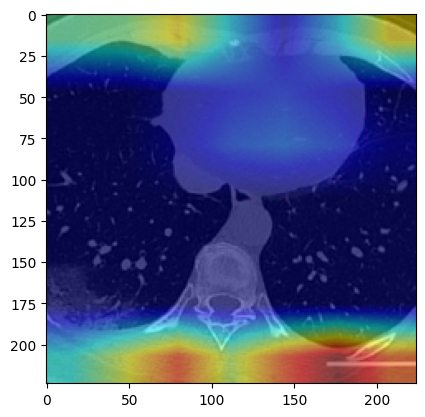

In [ ]:
# ResNet50

model_path = project_path + "/Experimental Results/ResNet50_exp_setting/Best_RetNet-50.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


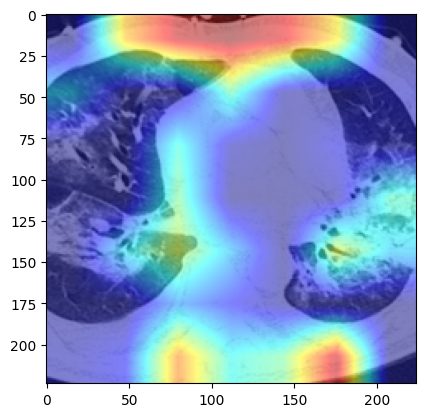

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


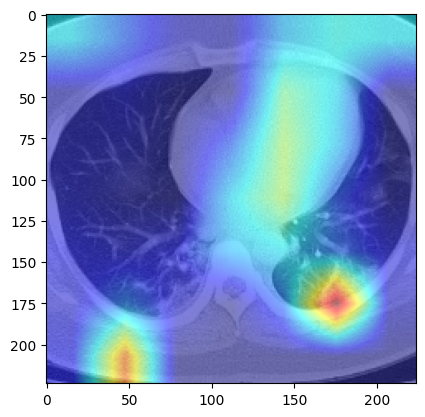

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


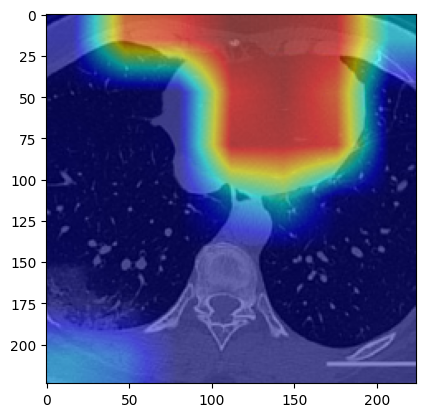

In [ ]:
# ResNet SE
model_path = project_path + "/Experimental Results/ResNet50_SE_exp_setting/Best_SERetNet-50.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


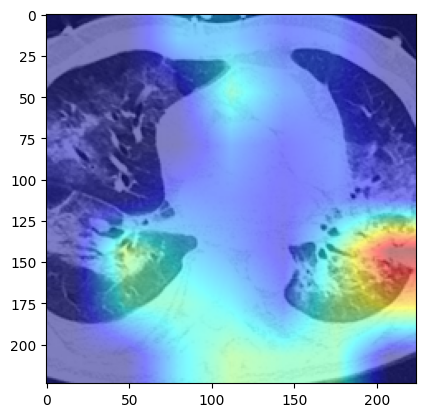

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


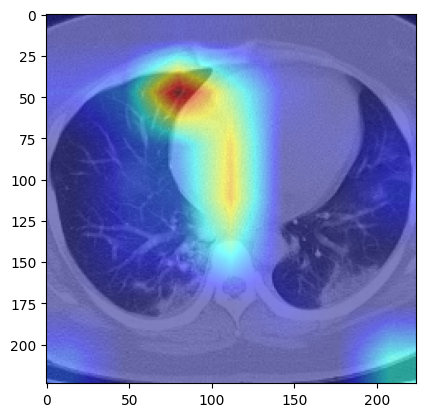

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


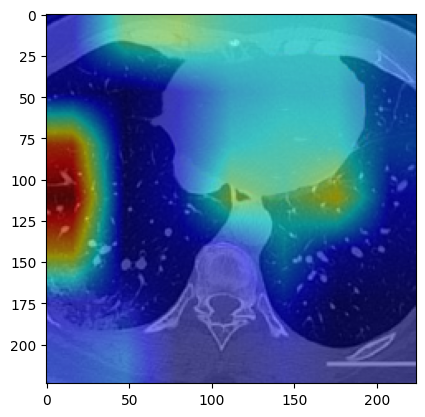

In [ ]:
# ResNet CBAM
model_path = project_path + "/Experimental Results/CBAMResNet50_lr=0.0006_epoch-20240103T144528Z-001/CBAMResNet50_lr=0.0006_epoch/4/Best_CBAMRetNet-50.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


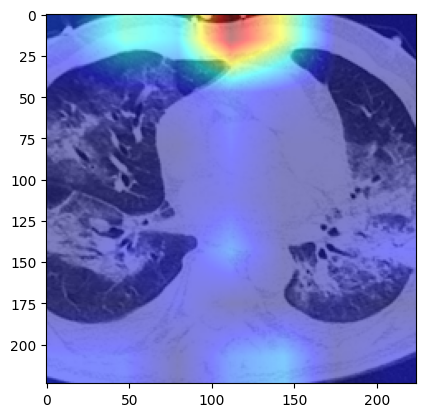

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


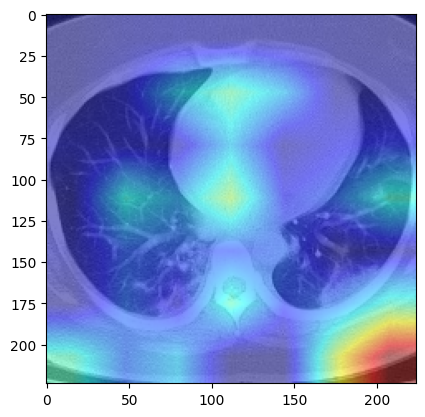

/content/drive/.shortcut-targets-by-id/1wse1sLeq7KeIBIsppZA5bo2MWNOn5NMg/Artificial Intelligence/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


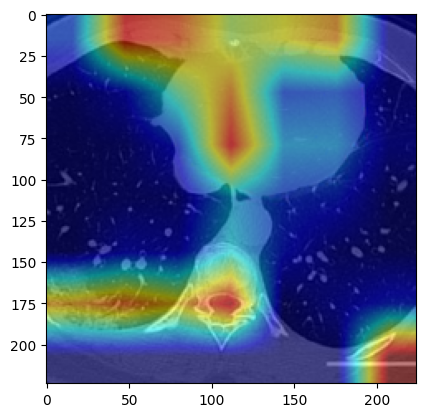

In [ ]:
# ResNet ECA
model_path = project_path + "/Experimental Results/ECAResNet50_with_lr_scheduler_lr=0.0006/Best_ECARetNet-50.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

# ResNeXt50

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


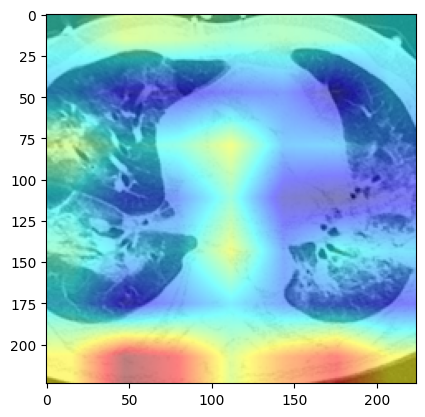

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


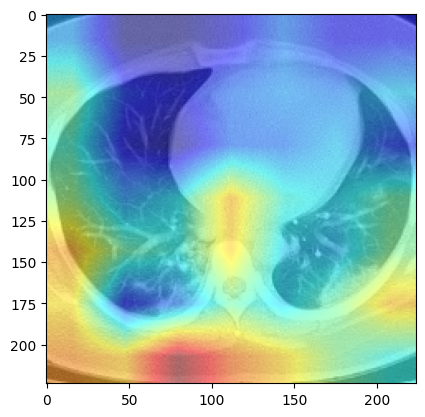

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


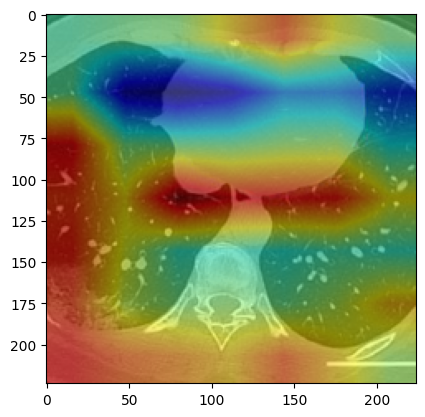

In [ ]:
# ResNeXt50-None
# PATH /Experimental Results/ResNeXt50_lr=0.0006_epoch/4/Best_ResNeXt50.pkl

model_path = project_path + "/Experimental Results/ResNeXt50_lr=0.0006_epoch/4/Best_ResNeXt50.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


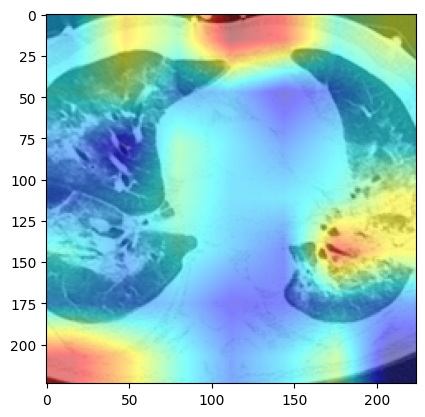

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


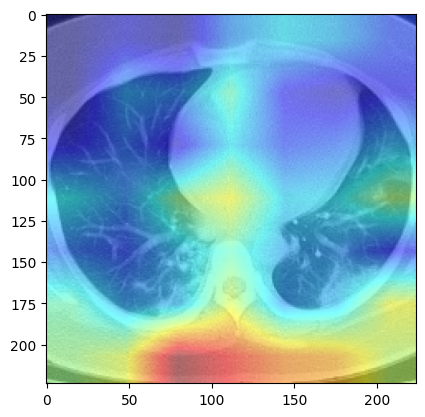

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


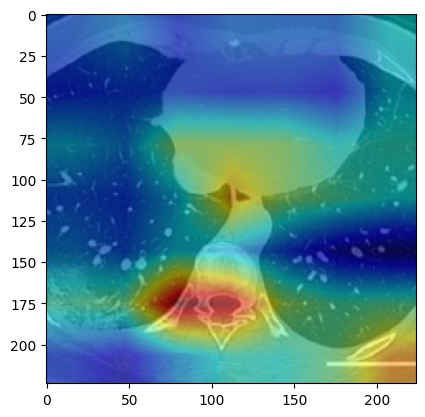

In [ ]:
# ResNeXt50-SE
# PATH /Experimental Results/ResNeXt50_SE_epoch/4/Best_ResNeXt50_SE.pkl

model_path = project_path + "/Experimental Results/ResNeXt50_SE_epoch/4/Best_ResNeXt50_SE.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


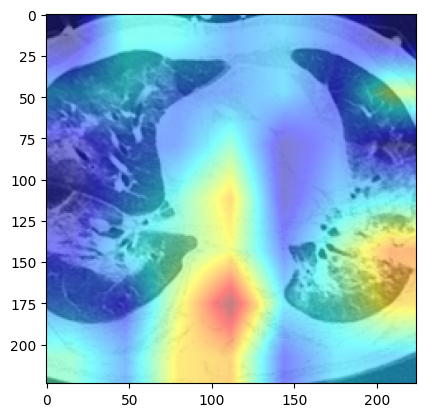

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


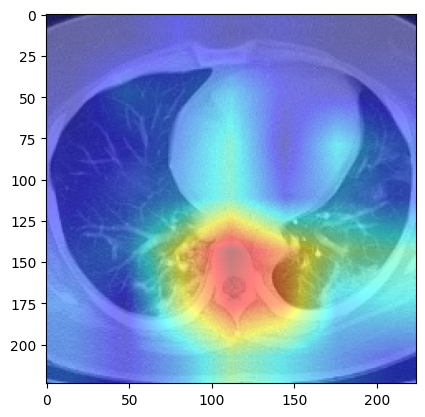

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


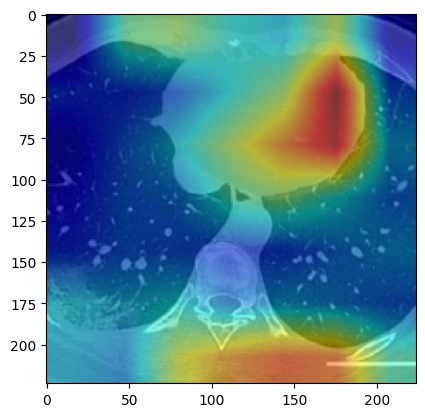

In [ ]:
# ResNeXt50-CBAM
# PATH /Experimental Results/ResNeXt50_CBAM/Best_ResNeXt50_CBAM.pkl

model_path = project_path + "/Experimental Results/ResNeXt50_CBAM/Best_ResNeXt50_CBAM.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


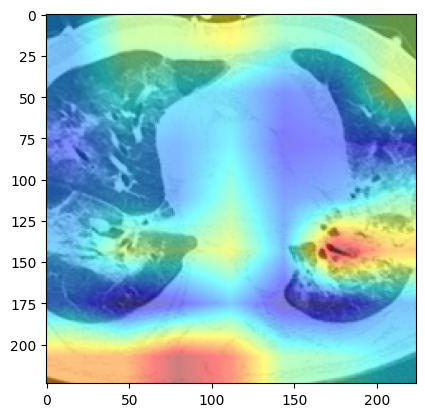

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


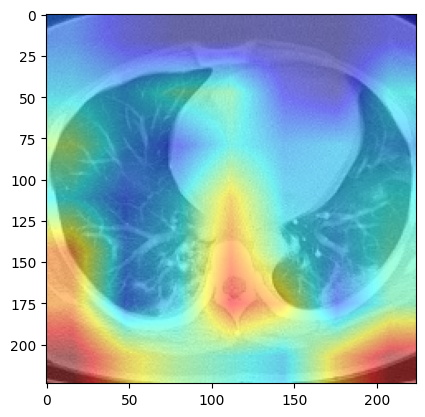

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


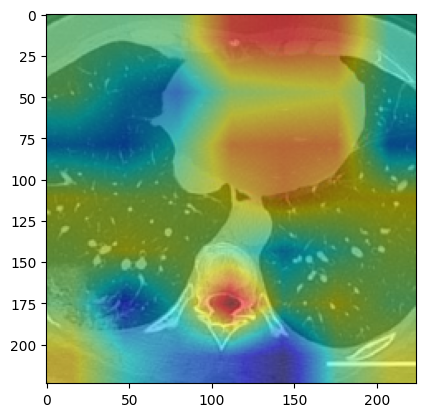

In [ ]:
# ResNeXt50-ECA
# PATH /Experimental Results/ResNeXt50_ECA/Best_ResNeXt50_ECA.pkl

model_path = project_path + "/Experimental Results/ResNeXt50_ECA/Best_ResNeXt50_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

# DenseNet121

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


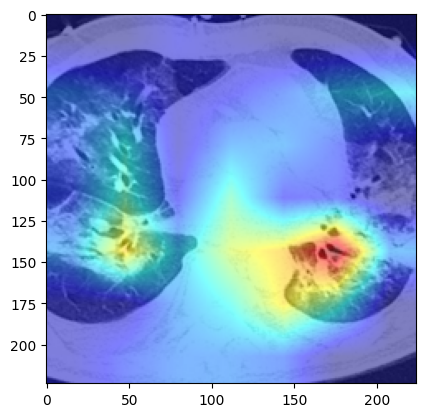

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


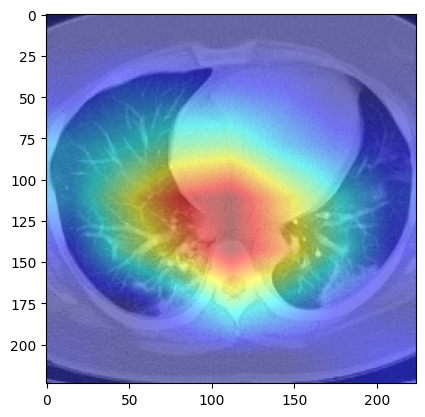

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


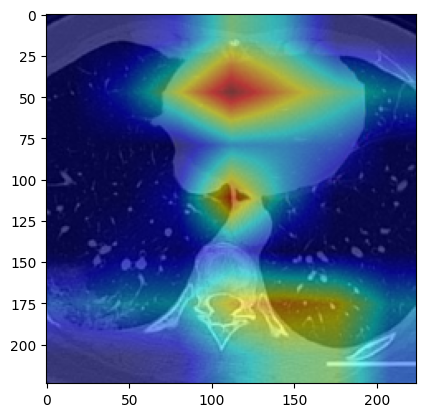

In [ ]:
# DenseNet121-None
# PATH /Experimental Results/DenseNet121_lr=0.0006_/4/Best_DenseNet121.pkl
model_path = project_path + "/Experimental Results/DenseNet121_lr=0.0006_/4/Best_DenseNet121.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


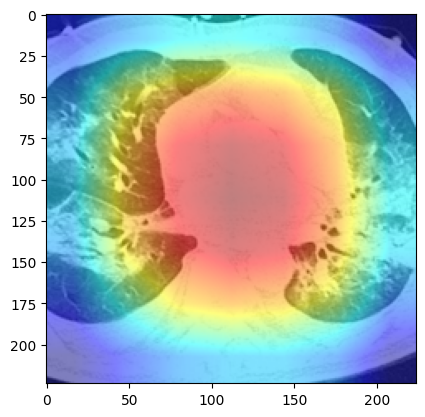

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


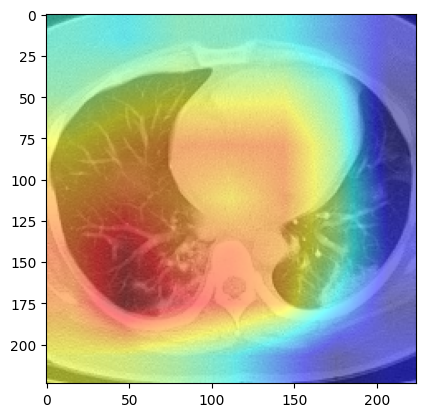

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


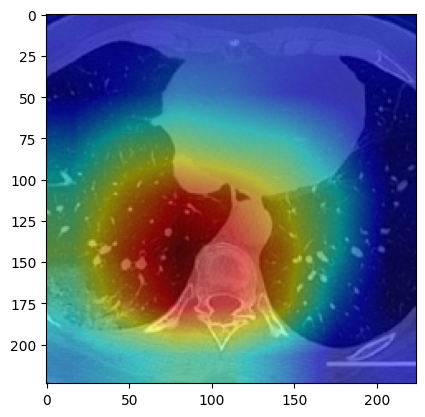

In [ ]:
# DenseNet121-SE-after
# PATH /Experimental Results/DenseNet121_SE_lr=0.0006_/4/Best_DenseNet121_SE.pkl
model_path = project_path + "/Experimental Results/DenseNet121_SE_lr=0.0006_/4/Best_DenseNet121_SE.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


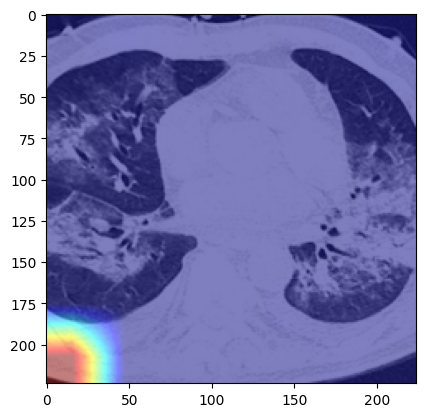

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


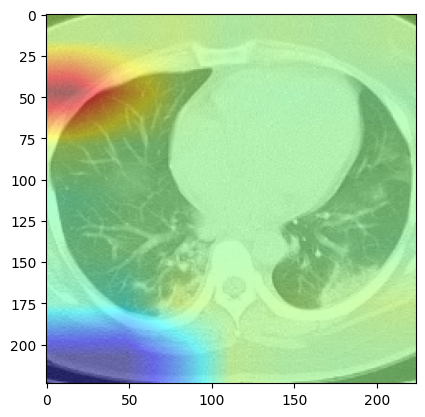

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


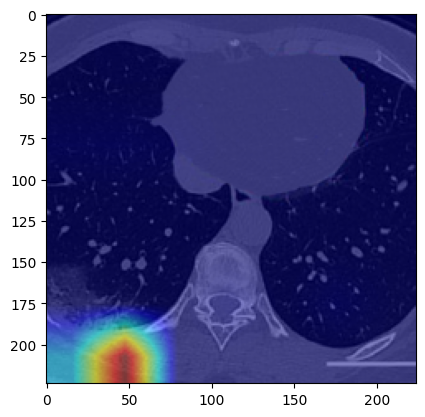

In [ ]:
# DenseNet121-CBAM-after
# PATH /Experimental Results/DenseNet121_CBAM_lr=0.0006_epoch/4/Best_DenseNet121_CBAM.pkl

model_path = project_path + "/Experimental Results/DenseNet121_CBAM_lr=0.0006_epoch/4/Best_DenseNet121_CBAM.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


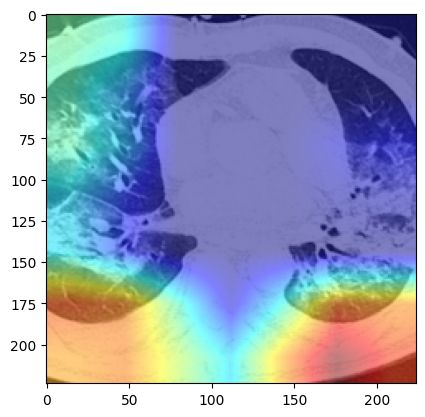

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


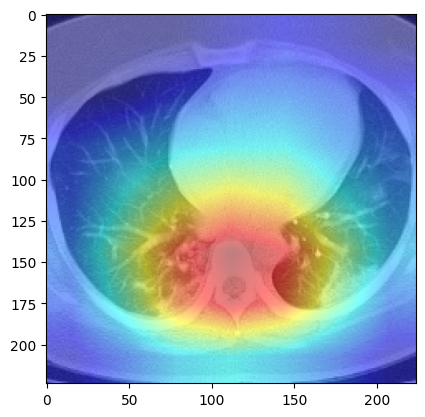

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


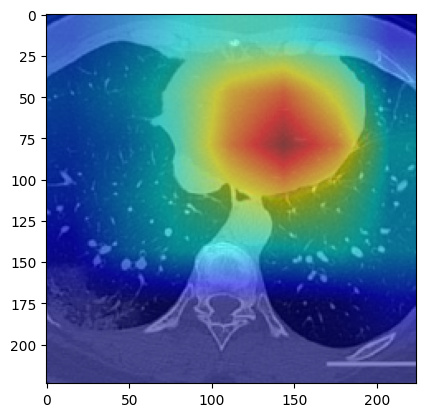

In [ ]:
# DenseNet121-ECA-after
# PATH /Experimental Results/DenseNet121_ECA_lr=0.0006_/4/Best_DenseNet121_ECA.pkl
model_path = project_path + "/Experimental Results/DenseNet121_ECA_lr=0.0006_/4/Best_DenseNet121_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


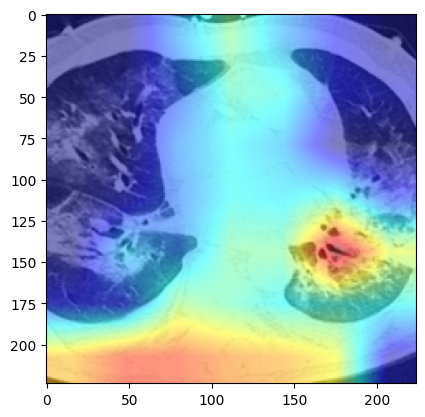

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


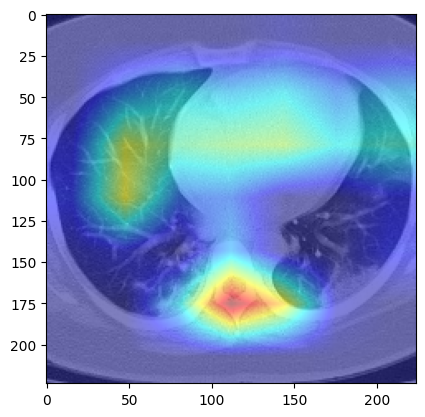

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


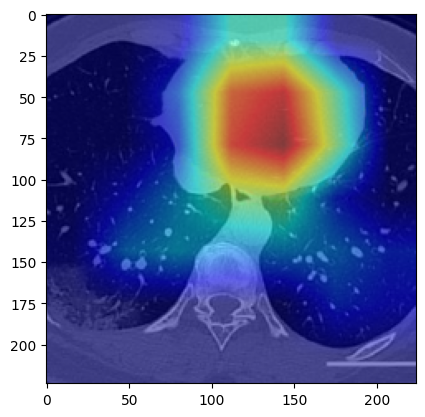

In [7]:
# DenseNet121-SE-before
# PATH /Experimental Results/DenseNet121_SE_New_LR0.0006_4/Best_DenseNet121_SE.pkl

model_path = project_path + "/Experimental Results/DenseNet121_SE_New_LR0.0006_4/Best_DenseNet121_SE.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


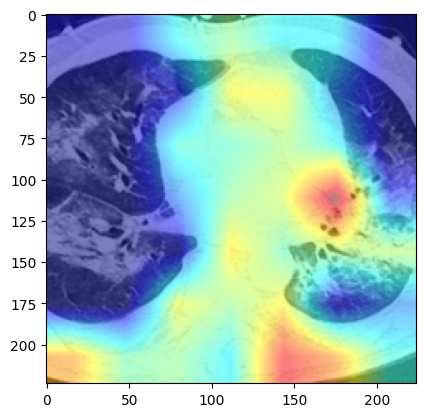

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


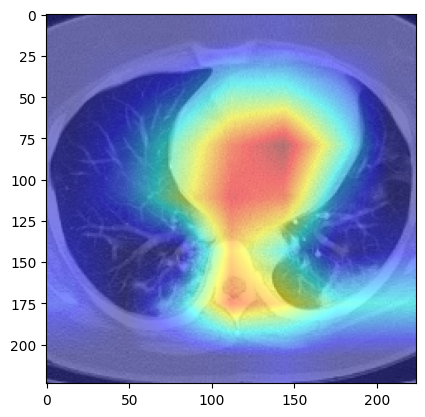

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


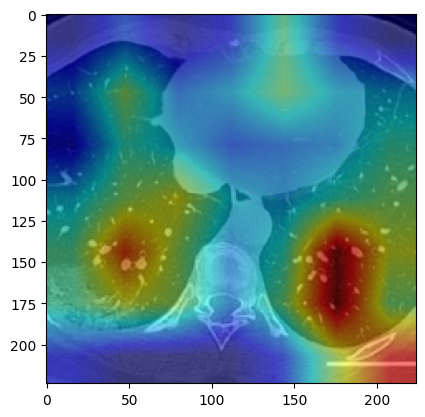

In [8]:
# DenseNet121-CBAM-before
# PATH /Experimental Results/DenseNet121_CBAM_New_LR0.0006_4/Best_DenseNet121_CBAM.pkl

model_path = project_path + "/Experimental Results/DenseNet121_CBAM_New_LR0.0006_4/Best_DenseNet121_CBAM.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


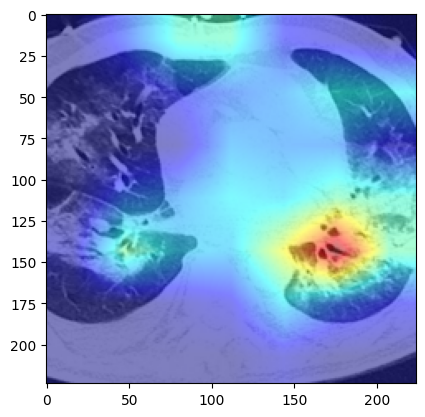

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


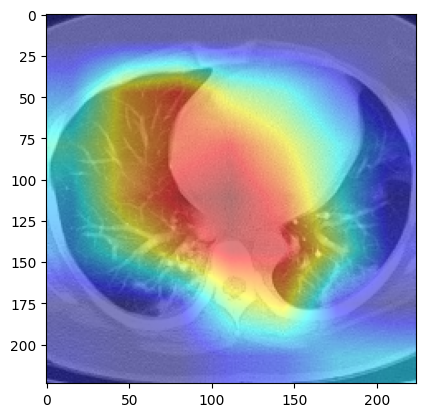

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


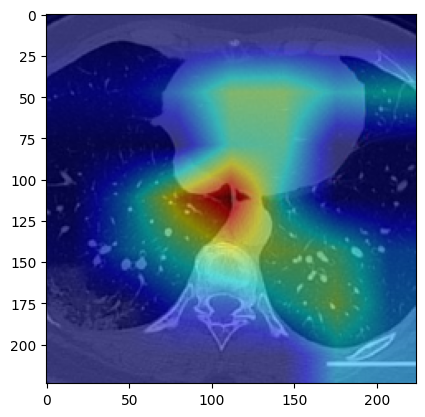

In [15]:
# DenseNet121-ECA-before
# PATH /Experimental Results/DenseNet121_ECA_New_LR0.0006_4/Best_DenseNet121_ECA.pkl

model_path = project_path + "/Experimental Results/DenseNet121_ECA_New_LR0.0006_4/Best_DenseNet121_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

# DenseNet169

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


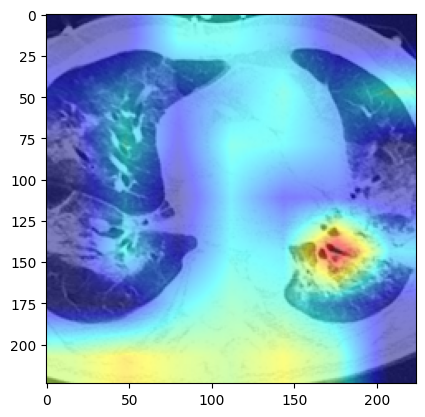

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


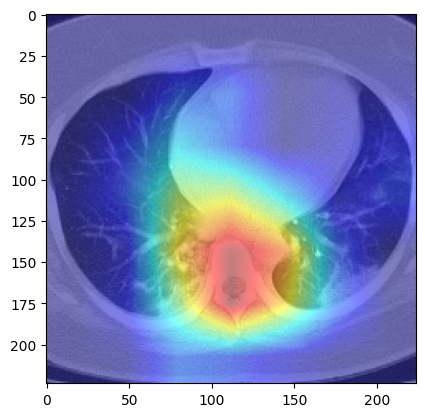

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


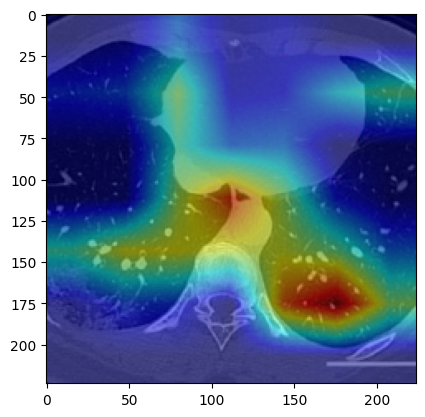

In [ ]:
# DenseNet169
# PATH /Experimental Results/DenseNet169_exp_setting/Best_DenseNet169.pkl

model_path = project_path + "/Experimental Results/DenseNet169_exp_setting/Best_DenseNet169.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


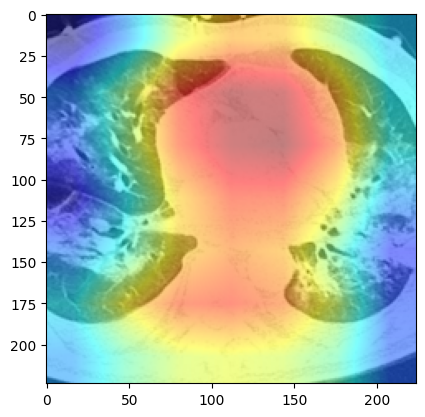

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


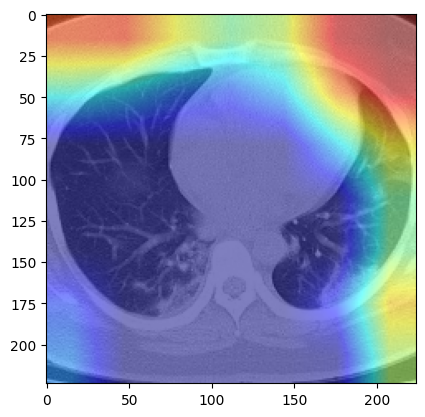

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


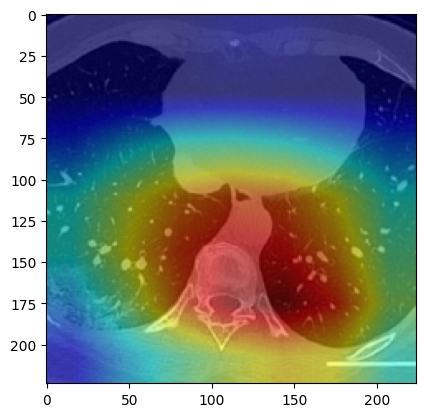

In [ ]:
# DenseNet169-SE-after
# PATH /Experimental Results/DenseNet169_ECA_lr=0.0006_/4/Best_DenseNet169_ECA.pkl

model_path = project_path + "/Experimental Results/DenseNet169_ECA_lr=0.0006_/4/Best_DenseNet169_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


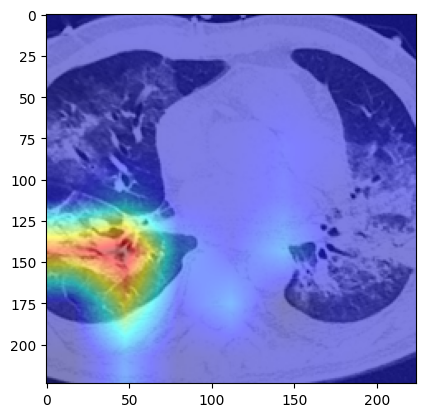

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


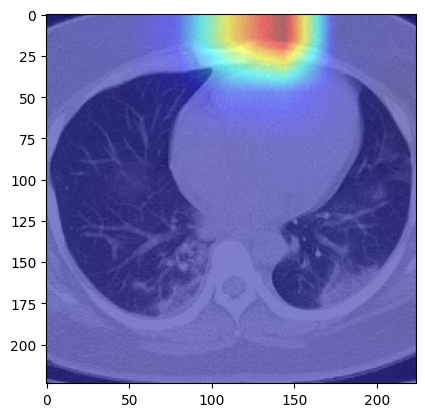

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


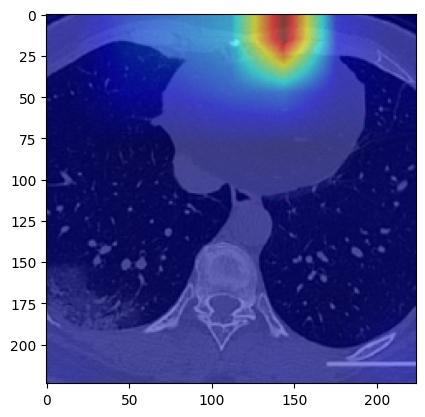

In [ ]:
# DenseNet169-CBAM-after
# PATH /Experimental Results/DenseNet169_CBAM_exp_setting/Best_DenseNet169_CBAM.pkl

model_path = project_path + "/Experimental Results/DenseNet169_CBAM_exp_setting/Best_DenseNet169_CBAM.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


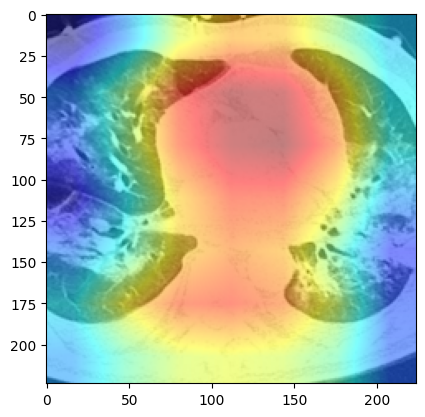

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


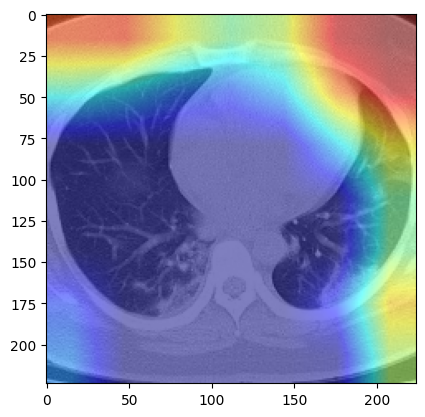

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


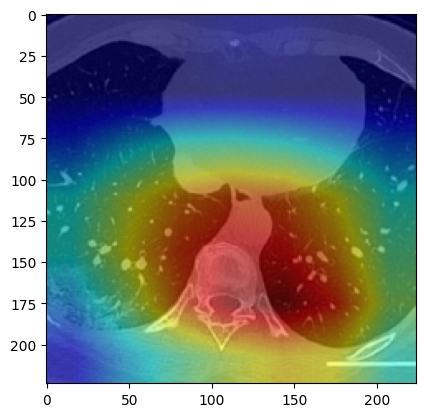

In [ ]:
# DenseNet169-ECA-after
# PATH /Experimental Results/DenseNet169_ECA_lr=0.0006_/4/Best_DenseNet169_ECA.pkl

model_path = project_path + "/Experimental Results/DenseNet169_ECA_lr=0.0006_/4/Best_DenseNet169_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


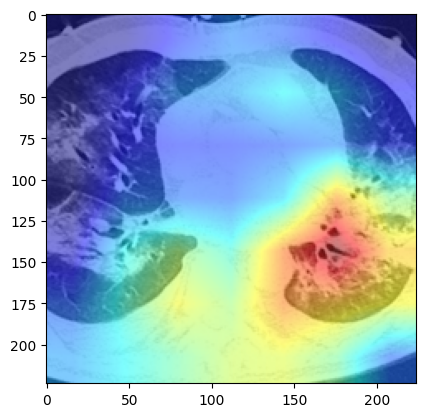

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


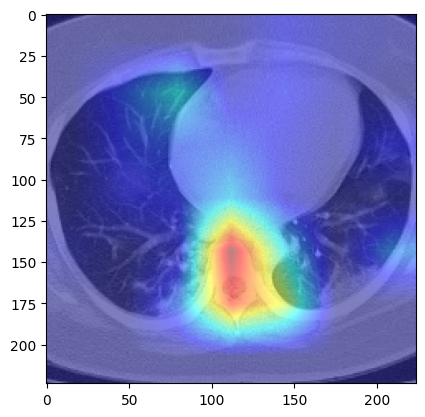

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


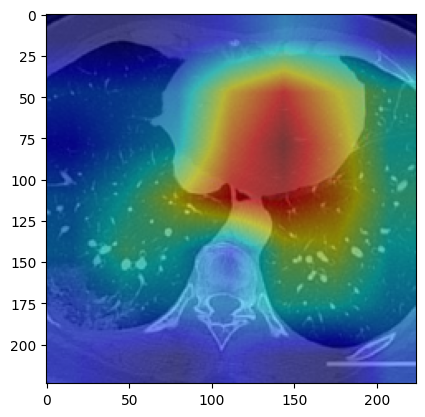

In [11]:
# DenseNet169-SE-before
# PATH /Experimental Results/DenseNet169_SE_New_LR0.0006_4/Best_DenseNet169_SE.pkl

model_path = project_path + "/Experimental Results/DenseNet169_SE_New_LR0.0006_4/Best_DenseNet169_SE.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


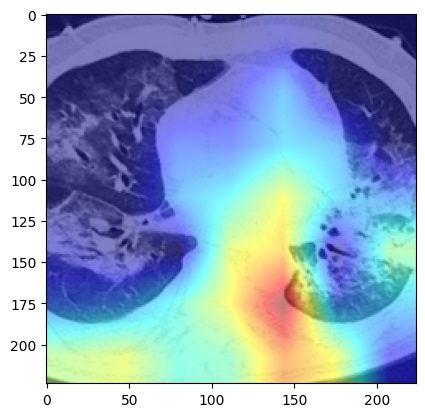

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


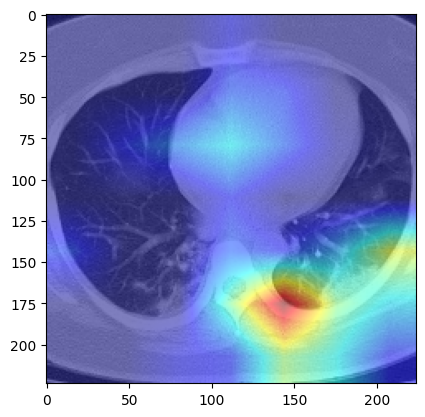

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


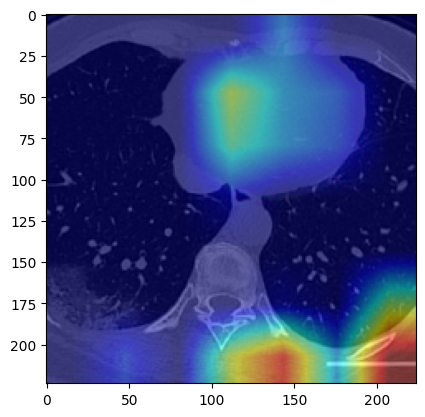

In [12]:
# DenseNet169-CBAM-before
# PATH /Experimental Results/DenseNet169_CBAM_New_LR0.0006_4/Best_DenseNet169_CBAM.pkl

model_path = project_path + "/Experimental Results/DenseNet169_CBAM_New_LR0.0006_4/Best_DenseNet169_CBAM.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


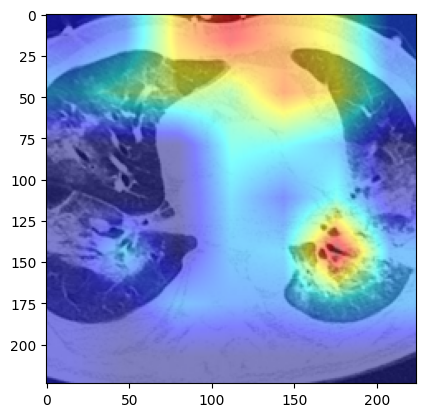

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


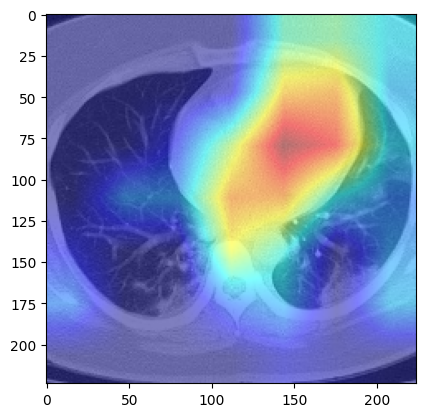

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


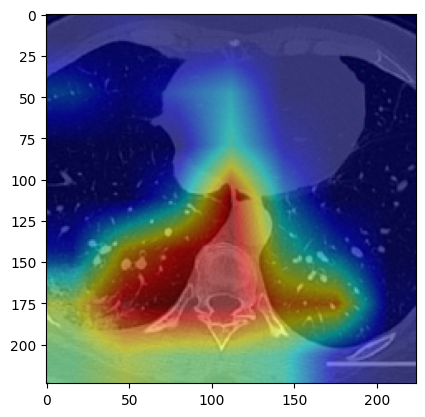

In [13]:
# DenseNet169-ECA-before
# PATH /Experimental Results/DenseNet169_ECA_New_LR0.0006_4/Best_DenseNet169_ECA.pkl

model_path = project_path + "/Experimental Results/DenseNet169_ECA_New_LR0.0006_4/Best_DenseNet169_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.tail]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

# ConvNeXt-Tiny

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


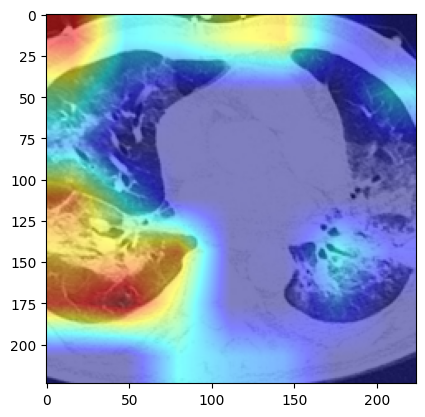

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


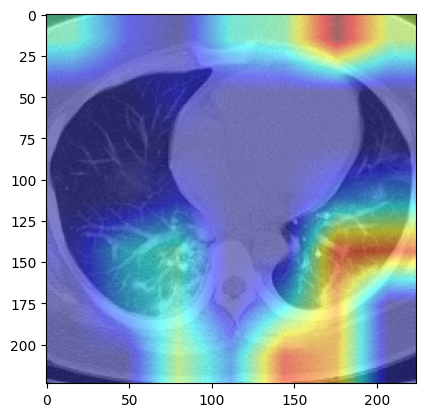

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


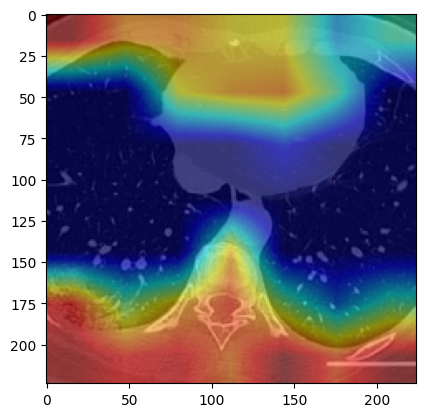

In [ ]:
# ConvNeXt-Tiny-none
# PATH /Experimental Results/ConvNeXtT_LR0.0006_4/Best_ConvNeXt_Tiny.pkl

model_path = project_path + "/Experimental Results/ConvNeXtT_LR0.0006_4/Best_ConvNeXt_Tiny.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.features]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


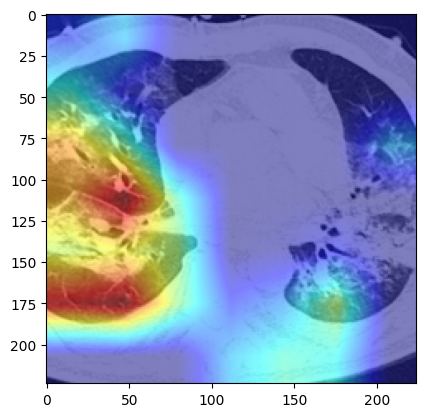

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


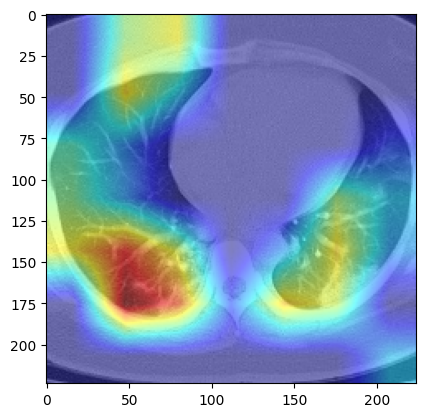

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


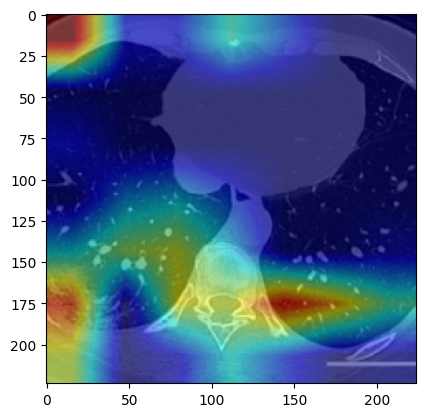

In [ ]:
# ConvNeXt-Tiny-SE
# PATH /Experimental Results/ConvNeXtT_SE_LR0.0006_4/Best_ConvNeXt_Tiny_SE.pkl

model_path = project_path + "/Experimental Results/ConvNeXtT_SE_LR0.0006_4/Best_ConvNeXt_Tiny_SE.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.features]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


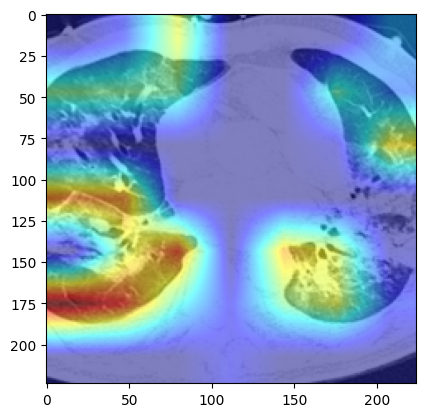

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


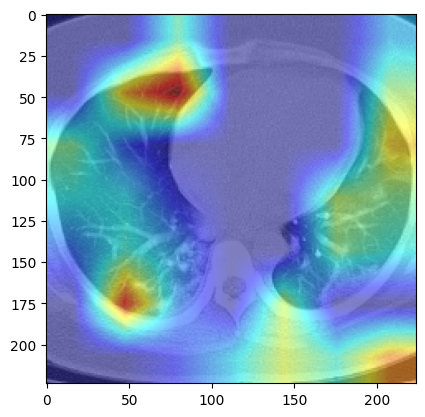

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


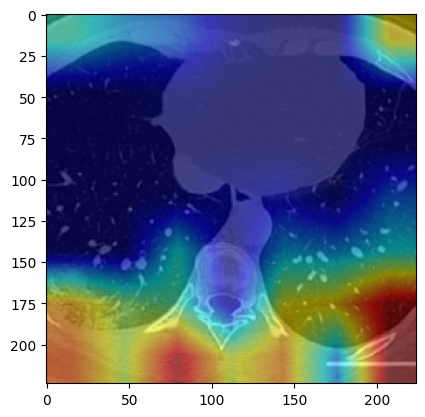

In [ ]:
# ConvNeXt-Tiny-CBAM
# PATH /Experimental Results/ConvNeXtT_CBAM_LR0.0006_4/Best_ConvNeXt_Tiny_CBAM.pkl

model_path = project_path + "/Experimental Results/ConvNeXtT_CBAM_LR0.0006_4/Best_ConvNeXt_Tiny_CBAM.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.features]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.26.20026989-p34-114_2%0.png


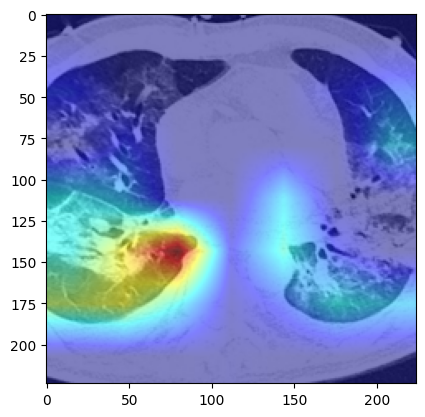

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.17.20024018-p17-61%3.png


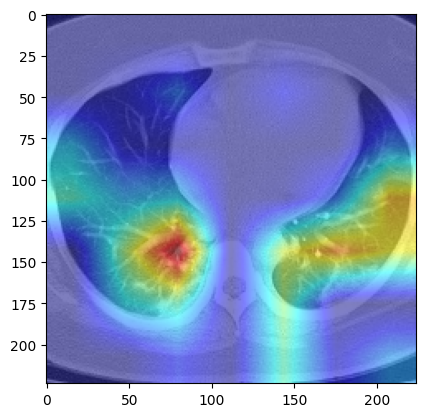

/content/drive/MyDrive/covid19/Covid19CT_Experiment/Database/CT_COVID/2020.02.24.20027052-p8-73%3.png


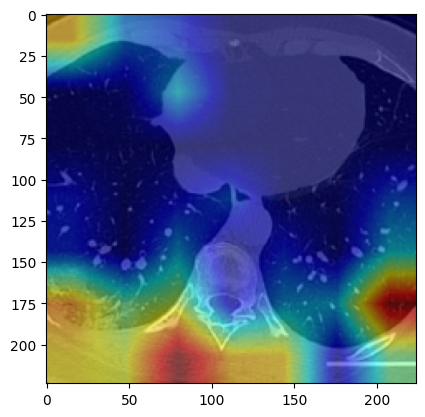

In [ ]:
# ConvNeXt-Tiny-ECA
# PATH /Experimental Results/ConvNeXtT_ECA_LR0.0006_4/Best_ConvNeXt_Tiny_ECA.pkl

model_path = project_path + "/Experimental Results/ConvNeXtT_ECA_LR0.0006_4/Best_ConvNeXt_Tiny_ECA.pkl"
model = torch.load(model_path, map_location=torch.device('cpu'))
target_layers_1 = [model.features]
cam = GradCAM(model=model, target_layers=target_layers_1)

gradcam_test(cam)